In [1]:
# import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.offline as offline_py
import chart_studio.plotly as py
import chart_studio

import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk import pos_tag
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer
import nltk
#nltk.download(['punkt', 'words', 'stopwords', 'averaged_perceptron_tagger', 'wordnet'])

import json
import time

In [2]:
def read_n_merge(summary_path, listings_path):
    """
    input: listings_summary_path, listings_path csv files 
    output: Pandas DataFrame keeping merged data frame with 'id', 'name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights', 'number_of_reviews', 'calculated_host_listings_count',
       'availability_365', 'number_of_reviews_ltm', 'description', 'accommodates' columns
    
    Description:
    1. reads listings_summary.csv file into a Pandas DataFrame
    2. reads listings.csv file columns 'description', 'accommodates' into a Pandas DataFrame
    3. Merges two dataframes in one
    """
    
    summary = pd.read_csv(summary_path)
    listings = pd.read_csv(listings_path, usecols = ['accommodates', 'description'])
    df = summary.join(listings, how = 'left')
    df.to_csv('df.csv', index = True)
    
    return df

In [3]:
def clean_summary(df):
    """
    input: Pandas merged DataFrame (summary + listings) to be cleaned
    output: Cleaned "sumamry" Pandas DataFrame
    
    Description:
    1. Drops columns with many many null values not to be used
    2. Renames mising apartment name
    3. Removes outliers in price column
    4. Drops listings available for more than 365 days a year
    5. Drops listings with availability less than one day and having less than five reviews in the last 12 months
    6. Fix availability with less than one days and more than five reviews in the last 12 months
    7. Drop listings with no descripition, number of people that accomodates and missing reviews in the last 12 months
    8. Drop listings without description an reviews in the last 12 months
    9. Fix missing descriptions by copying the name to the description field
    
    """
    
    # drop columns with many many null values not to be used
    df = df.drop(columns = ['neighbourhood_group', 'last_review', 'reviews_per_month', 'license'], axis = 1)
    # rename mising apartment names to be kept 
    df.name = df.name.fillna('name_missing')
    # rename with 'host_name_missing' listing names in the host_name column 
    df.host_name = df.host_name.fillna('host_name_missing')
    # remove outliers in price column
    df = df.drop(index = df.loc[df.price > 2000].index, axis = 0)
    # drop appartments available for more than 365 days a year
    df = df.drop(index = df.loc[df.minimum_nights > 365].index, axis = 0)
    # drop listings with availability less than one day and having less than five reviews in the last 12 months
    df = \
        df.drop(index = df.loc[(df.availability_365 < 1) & (df.number_of_reviews_ltm < 5)]\
            .index, axis = 0)
    # fix availability with less than one days and more than five reviews in the last 12 months
    mean_365 = int(df.availability_365.mean())
    idx_365 = df.loc[(df.availability_365 < 1) & (df.number_of_reviews_ltm >= 5)].index
    df.loc[idx_365, 'availability_365'] = mean_365
    # drop listings with no descripition, number of people that accomodates and missing reviews in the last 12 months
    df = df\
        .drop(index = df[(df.accommodates.isnull()) & (df.number_of_reviews_ltm == 0) & (df.description.isnull())]\
          .index, axis = 0)
    # drop listings without description an reviews in the last 12 months
    df = df\
        .drop(index = df[(df.description.isnull()) & (df.number_of_reviews_ltm < 5)]\
          .index, axis = 0)
    # fix the rest of missing descriptions by copying the name to the description field
    for i in df[df.description.isnull()].index:
        df.loc[i,'description'] = df.loc[i,'name']
    
    df = df.reset_index()
    df.to_csv('df_clean.csv', index = True)
        
    return df

In [4]:
def tokenize(text):
    """
    Input: 
    a text string found in each reccord (str)
    Output:
    a list of stems 
    
    Desscription:
    Function that cterates stems - word tokens
    1. replaces urls with the 'url' string
    2. replaces punctuation marks with white spaces
    3. creates lists of words out of the initial text
    4. reduces words to their stems - not necessary words to be understood by humans
    
    
    """
    # regex pattern to identify an url
    url_regex = 'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+'
    # replace urls with a 'url' string
    text = re.sub(url_regex, 'url', text)
    # text normalization - remove punctuation and lower case
    text = re.sub(r"[^a-zA-Z0-9]", " ", text.lower())
    # tokenize text to words
    words = [w for w in word_tokenize(text) if w not in stopwords.words("french")]
    # assign "Parts of Speech": POS to every word - words output is a tupple
    #words = pos_tag(words)
    # Reduce words to their root form by specifying Part of Speech: verb
    #lemmed = [WordNetLemmatizer().lemmatize(w[0], pos = 'v') for w in words]
    # Reduce words to their stems - that is their root form not exactly a word to be understood 
    stemmed = [PorterStemmer().stem(w) for w in words]
    
    return stemmed

def check_elev_desc(df):
    """
    Input: pandas DataFrame with description column
    Output: pandas DataFrame with a T/F field exporting information about elevator presence in the listing
    
    Desscription:
    Check presence of the elevator from description text
    Function that uses the tokenizer function to engineer a field with elevator information in the listing
    1. checks if 'elev' or 'ascensor' stems are present in the description and creates a binary feature out of it
    2. Drops description column
    """
    
    start = time.time()
    toks_generator = (tokenize(desc) for desc in df.description.values)
    toks_iterator = iter(toks_generator)
    elev_list = [('elev' or 'ascenseur') in tok for tok in toks_iterator]
    stop = time.time()
    print(f'\n Time: {round((stop - start)/60, 2)} minutes')
    
    elev_series = pd.Series((v for v in elev_list))
    df = df.assign(elev = elev_series)
    
    df = df.drop(columns = ['description'], axis = 1)
    
    return df

In [5]:
def one_hot_room_type(data):
    '''
    Create a binary variable for each category in the room_type column and merge it to initial data
    '''
    room_types = pd.get_dummies(data.room_type)
    room_types\
    .rename(columns = {label:label.lower().replace(' ', '_').replace('/', '_') for label in room_types.columns.tolist()},\
                      inplace = True)
    data = data.join(room_types, how = 'left')
    data.to_csv('data.csv', index = False)
    
    return data

In [6]:
def group_n_save(data):
    '''
    Group all data by neighbourhood
    '''
    
    groupped = pd.pivot_table(data, values=['price',\
                                        'minimum_nights',\
                                        'availability_365',\
                                        'elev',\
                                        'entire_home_apt',\
                                        'hotel_room',\
                                        'private_room',\
                                        'shared_room'],\
                          index=['neighbourhood'],
                    aggfunc={'price': [min, max, np.mean],
                             'minimum_nights': [min, max, np.mean],
                             'availability_365': [min, max, np.mean],
                             'elev': np.sum,
                             'entire_home_apt': np.sum,
                             'hotel_room': np.sum,
                             'private_room': np.sum,
                             'shared_room': np.sum})
    groupped = groupped.reset_index()
    groupped.to_csv('groupped.csv', index = False)
    
    return groupped


In [7]:
def read_n_fix(groupped):

    groupped_cols =  {'Unnamed: 0':'Neighbourhood',
                 'availability_365': 'Max availability in 365 days',
                 'availability_365.1': 'Mean availability in 365 days',
                 'availability_365.2': 'Min availability in 365 days',
                 'elev': 'Sum of Elevators', 
                 'entire_home_apt': 'Sum of entire home apartments',
                 'hotel_room': 'Sum of entire hotel rooms',
                 'private_room': 'Sum of entire private rooms',
                 'shared_room': 'Sum of shared rooms',
                 'minimum_nights': 'Max minimum nights to book',
                 'minimum_nights.1': 'Mean minimum nights to book',
                 'minimum_nights.2': 'min_minimum_nights',
                 'price': 'Max price',
                 'price.1': 'Mean price',
                 'price.2': 'Min price'}
    
    groupped = pd.read_csv('groupped.csv')
    groupped.rename(columns = groupped_cols, inplace = True)
    groupped = groupped.drop(index = groupped.iloc[0:2,:].index, axis = 0)

    for field in groupped.columns:
        if field not in 'neighbourhood':
            groupped[field] = groupped[field].astype('float').astype('int')
            
    groupped.to_csv('groupped.csv', index = False)
            
    return groupped


In [8]:
'''
df = read_n_merge('summary_listings_paris.csv', 'listings_paris.csv')
df = clean_summary(df)
data = check_elev_desc(df)
data = one_hot_room_type(data)
groupped = group_n_save(data)
groupped = read_n_fix(groupped)
'''

"\ndf = read_n_merge('summary_listings_paris.csv', 'listings_paris.csv')\ndf = clean_summary(df)\ndata = check_elev_desc(df)\ndata = one_hot_room_type(data)\ngroupped = group_n_save(data)\ngroupped = read_n_fix(groupped)\n"

In [9]:
def main():
    encoding = 'utf-8'
    # df = read_n_merge('listings_summary.csv', 'listings.csv')
    df = pd.read_csv('df.csv', encoding = encoding)
    df_clean = pd.read_csv('df_clean.csv', encoding = encoding)
    data = pd.read_csv('data.csv', encoding = encoding)
    groupped = pd.read_csv('groupped.csv', encoding = encoding)
    
    return df, df_clean, data, groupped

In [10]:
df, df_clean, data, groupped = main()

In [11]:
def connect():
    '''Connect with chartstudio'''
    username = 'chpolyzo' # Add username
    api_key = '' # Add api key 

    chart_studio.tools.set_credentials_file(username = username, api_key = api_key)



def viz_nulls(df):
    null_series = df.isnull().sum()
    fig = px.bar(null_series,\
             x = null_series.index,
             y = null_series.values)

    fig.update_layout(
        title="Null Values - Summary Dataset",
        title_x = 0.5,
        xaxis_title = "DataFrame Columns",
        yaxis_title = "Count"
        )
    offline_py.plot(fig, show_link = False, filename = 'df_null_vals.html')
    
    fig.show()
    
    return fig

def price_violins(data):
    """
    Visualize price distribution in Paris
    """
    
    fig = px.violin(data, y = "price", x = "neighbourhood", 
          hover_data = data.columns)
    
    fig.update_layout(
        title="Price distribution in diferent Neighborhoods in Paris",
        title_x = 0.5,
        xaxis_title = "Neighbours",
        yaxis_title = "Price"
        )
    
    offline_py.plot(fig, show_link = False, filename = 'price_violins.html')

    fig.show()
    
    return fig

def viz_neighbourhood(data):
    """
    Visualize 30 most popular neighbourhoods 
    """
    fig = px.bar(data,\
             x = data.neighbourhood.value_counts().index,\
             y = data.neighbourhood.value_counts().values)

    fig.update_layout(
        title="Most Popular Neighbours",
        title_x = 0.5,
        xaxis_title = "Neighbours",
        yaxis_title = "Count"
        )
    offline_py.plot(fig, show_link = False, filename = 'all_neighbours.html')

    fig.show()
    
    return fig


def plot_plt_neigh(data):
    
    plt.figure(figsize = [30, 10])
    plt.bar(data.neighbourhood.value_counts().head(30).index, data.neighbourhood.value_counts().head(30).values)
    plt.xticks(fontsize = 18, rotation = 90)
    plt.yticks(fontsize = 18);
    
def create_map(groupped, col_to_viz, save_as):
    
    with open('map.geojson', encoding = 'utf-8') as f:
        gj = json.load(f)


    fig = px.choropleth_mapbox(groupped, geojson = gj, color = col_to_viz,
                        locations = "neighbourhood", featureidkey = "properties.l_aroff",
                        center={"lat": 48.8647, "lon": 2.3490},
                        mapbox_style = "carto-positron", zoom = 10,
                        hover_data=["Sum of entire private rooms", "Sum of shared rooms",\
                                    "Sum of entire home apartments", "Sum of entire hotel rooms"])

    fig.update_geos(fitbounds = "locations", visible=True)
    fig.update_layout(margin = {"r":0,"t":0,"l":0,"b":0})
    
    offline_py.plot(fig, show_link = False, filename = save_as)
    
    fig.show()
    
    return fig

In [12]:
def price_boxes(data):
    """
    Visualize price distribution in Paris
    """
    
    fig = px.box(data, y = "price", x = "neighbourhood", 
          hover_data = data.columns)
    
    fig.update_layout(
        title="Price distribution in diferent Neighborhoods in Paris",
        title_x = 0.5,
        xaxis_title = "Neighbours",
        yaxis_title = "Price"
        )
    
    offline_py.plot(fig, show_link = True, filename = 'box_violins.html')

    fig.show()
    
    return fig

In [13]:
connect()

In [14]:
null_vals = viz_nulls(df)
py.plot(null_vals, filename = 'null_vals_paris', auto_open=True)

'https://plotly.com/~chpolyzo/33/'

## How do the prices range across neighbourhoods in Paris?

In [15]:
price_neigh_violins = price_violins(data)
#py.plot(price_neigh_violins, filename = 'price_violins_paris', auto_open = True)

In [16]:
price_neigh_boxes = price_boxes(data)
#py.plot(price_neigh_boxes, filename = 'price_boxes_paris', auto_open = True)

The least expensive neighbours are Buttes Chaumont, Buttrs-Monmarte, Gobelins and Menllmontant. The most expensive neighbours are Elyse, Luxembourg, Palais-Bourbon and Louvre,

## Which are the most popular neighbours in Paris?

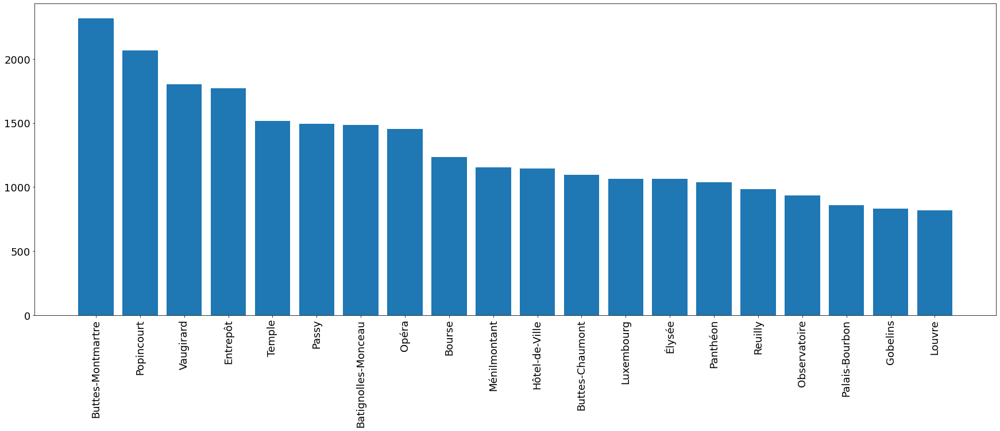

In [17]:
neigh = viz_neighbourhood(data)
py.plot(neigh, filename = 'all_neighbours_paris', auto_open=True)
plot_plt_neigh(data)

The most popular neighbourhood in Paris is Buttes-Montmarte, with 2316 listings, followed by Popincourt with 2065 listings and in the third-place Vaugirard with 1802 listings. 

## How likely is it for an apartment to have an elevator in different neighbourhoods?

In [18]:
elevators_map = create_map(groupped, "Sum of Elevators", "elevators_map_paris.html")
py.plot(elevators_map, filename = "elevators_map_paris", auto_open=True)

'https://plotly.com/~chpolyzo/40/'

Elyse neighbourhood seems to have the most elevators and Gobelins the least.

In [ ]:
price_map = create_map(groupped, "Mean price", "mean_price_map_paris.html")
py.plot(price_map, filename = "price_map_paris", auto_open=True)

In [ ]:
availability_map = create_map(groupped, "Mean availability in 365 days", "availability_map.html")
py.plot(availability_map, filename = "availability_map_paris", auto_open=True)

In [ ]:
min_nights_map = create_map(groupped, "Mean minimum nights to book", "mean_minimum_nights_map.html")
py.plot(min_nights_map, filename = "min_nights_map_paris", auto_open=True)